<a href="https://colab.research.google.com/github/Suryaanugrah2001/Proyek-Polusi-Kendaraan-Listrik/blob/main/Proyek_Polusi_Kendaraan_Listrik.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
plt.style.use('fivethirtyeight')
import seaborn as sns
import folium

In [2]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [3]:
from google.colab import files
data = pd.read_csv("/content/gdrive/MyDrive/Colab Notebooks/kendaraanlistrik.csv")
data = pd.DataFrame(data)
data

,VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
0,5YJ3E1EB4L,Yakima,Yakima,WA,98908.0,2020,TESLA,MODEL 3,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,322,0,14.0,127175366,POINT (-120.56916 46.58514),PACIFICORP,5.307700e+10
1,5YJ3E1EA7K,San Diego,San Diego,CA,92101.0,2019,TESLA,MODEL 3,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,220,0,NaN,266614659,POINT (-117.16171 32.71568),NaN,6.073005e+09
2,7JRBR0FL9M,Lane,Eugene,OR,97404.0,2021,VOLVO,S60,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,22,0,NaN,144502018,POINT (-123.12802 44.09573),NaN,4.103900e+10
3,5YJXCBE21K,Yakima,Yakima,WA,98908.0,2019,TESLA,MODEL X,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,289,0,14.0,477039944,POINT (-120.56916 46.58514),PACIFICORP,5.307700e+10
4,5UXKT0C5XH,Snohomish,Bothell,WA,98021.0,2017,BMW,X5,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,14,0,1.0,106314946,POINT (-122.18384 47.8031),PUGET SOUND ENERGY INC,5.306105e+10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
124711,5YJ3E1EB6N,Snohomish,Monroe,WA,98272.0,2022,TESLA,MODEL 3,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not b...,0,0,39.0,192999061,POINT (-121.98087 47.8526),PUGET SOUND ENERGY INC,5.306105e+10
124712,KNDCM3LD2L,Pierce,Tacoma,WA,98406.0,2020,KIA,NIRO,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,26,0,27.0,113346250,POINT (-122.52054 47.26887),BONNEVILLE POWER ADMINISTRATION||CITY OF TACOM...,5.305306e+10
124713,7SAYGDEE0P,Whatcom,Bellingham,WA,98226.0,2023,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not b...,0,0,42.0,232751305,POINT (-122.49756 48.7999),PUGET SOUND ENERGY INC||PUD NO 1 OF WHATCOM CO...,5.307300e+10
124714,1G1FW6S03J,Pierce,Tacoma,WA,98444.0,2018,CHEVROLET,BOLT EV,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,238,0,29.0,102589007,POINT (-122.46495 47.16778),BONNEVILLE POWER ADMINISTRATION||CITY OF TACOM...,5.305307e+10


In [4]:
data.isnull().sum()

VIN (1-10)                                             0
County                                                 2
City                                                   2
State                                                  0
Postal Code                                            2
Model Year                                             0
Make                                                   0
Model                                                181
Electric Vehicle Type                                  0
Clean Alternative Fuel Vehicle (CAFV) Eligibility      0
Electric Range                                         0
Base MSRP                                              0
Legislative District                                 297
DOL Vehicle ID                                         0
Vehicle Location                                      29
Electric Utility                                     473
2020 Census Tract                                      2
dtype: int64

In [5]:
data.shape

(124716, 17)

In [7]:
#menghapus missing value
evp_data=data.dropna()
evp_data.isnull().sum()

VIN (1-10)                                           0
County                                               0
City                                                 0
State                                                0
Postal Code                                          0
Model Year                                           0
Make                                                 0
Model                                                0
Electric Vehicle Type                                0
Clean Alternative Fuel Vehicle (CAFV) Eligibility    0
Electric Range                                       0
Base MSRP                                            0
Legislative District                                 0
DOL Vehicle ID                                       0
Vehicle Location                                     0
Electric Utility                                     0
2020 Census Tract                                    0
dtype: int64

In [8]:
print("Data Mentah", data.shape)
print("Data yang sudah dibersihkan",evp_data.shape)

Data Mentah (124716, 17)
Data yang sudah dibersihkan (124038, 17)


Text(0.5, 1.0, 'Heatmap Korelasi')

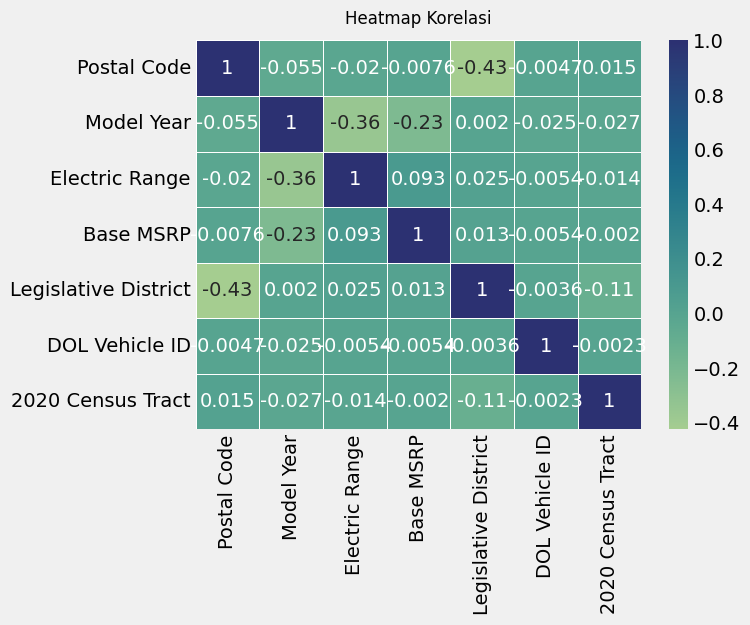

In [10]:
heatmap=sns.heatmap(evp_data.corr(method ='pearson'), annot=True,cmap="crest", linewidth=.7)
heatmap.set_title('Heatmap Korelasi', fontdict={'fontsize':12}, pad=12)

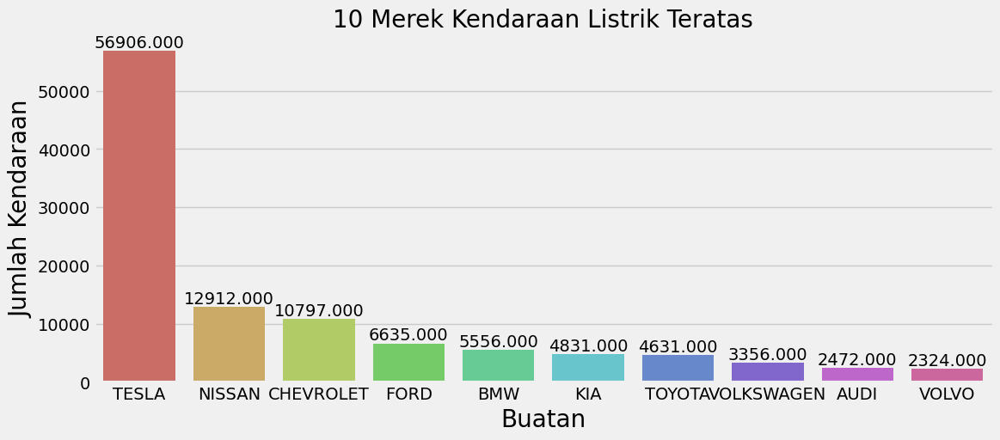

In [12]:
plt.figure(figsize=(12,5))
ax=sns.barplot(x=evp_data['Make'].value_counts().index[:10], y=evp_data["Make"].value_counts()[:10], data=evp_data, palette='hls')
sns.despine(top=True, right=True, left=False, bottom=False)
plt.xlabel('Buatan', fontsize=20)
plt.ylabel('Jumlah Kendaraan', fontsize=20)
for p in ax.patches:
    ax.annotate('{:.3f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()),
                ha='center', va='bottom',color='black')
plt.title('10 Merek Kendaraan Listrik Teratas', fontsize=20)
plt.show()

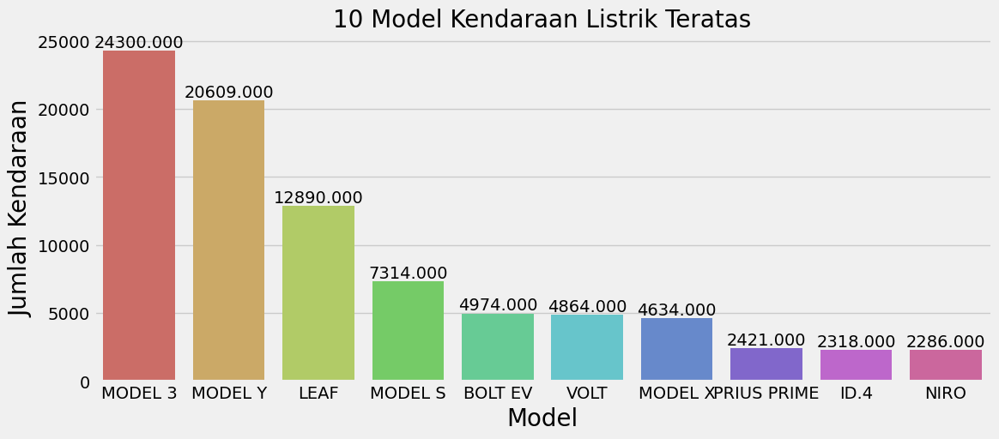

In [14]:
plt.figure(figsize=(12,5))
ax=sns.barplot(x=evp_data['Model'].value_counts().index[:10], y=evp_data["Model"].value_counts()[:10], data=evp_data, palette='hls')
sns.despine(top=True, right=True, left=False, bottom=False)
plt.xlabel('Model', fontsize=20)
plt.ylabel('Jumlah Kendaraan', fontsize=20)
for p in ax.patches:
    ax.annotate('{:.3f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()),
                ha='center', va='bottom',color='black')
plt.title('10 Model Kendaraan Listrik Teratas', fontsize=20)
plt.show()

In [17]:
makes = evp_data['Make'].value_counts().index[:10]
for make in makes:
    make_model = evp_data[evp_data['Make'] == make]


    count_model=make_model['Model'].value_counts().index.value_counts().sum()

    model_counts = make_model['Model'].value_counts()
    fig = px.pie(evp_data, names=model_counts.index, values=model_counts, height=400, title=f'persentase Model Kendaraan Listrik untuk {make} ({count_model} Models)')
    fig.show()

In [20]:
makes = evp_data['Make'].value_counts().index[:10]
for make in makes:
    make_model = evp_data[evp_data['Make'] == make]

    count_model=make_model['Electric Vehicle Type'].value_counts().index.value_counts().sum()

    model_counts = make_model['Electric Vehicle Type'].value_counts()
    fig = px.pie(evp_data, names=model_counts.index, values=model_counts, height=400, title=f'Persentase tipe kendaraan listrik untuk {make}')
    fig.show()

In [22]:
px.pie(evp_data,names=evp_data['Electric Vehicle Type'].value_counts().index,values=evp_data["Electric Vehicle Type"].value_counts(),height=400,title='Jenis Kendaraan Listrik')

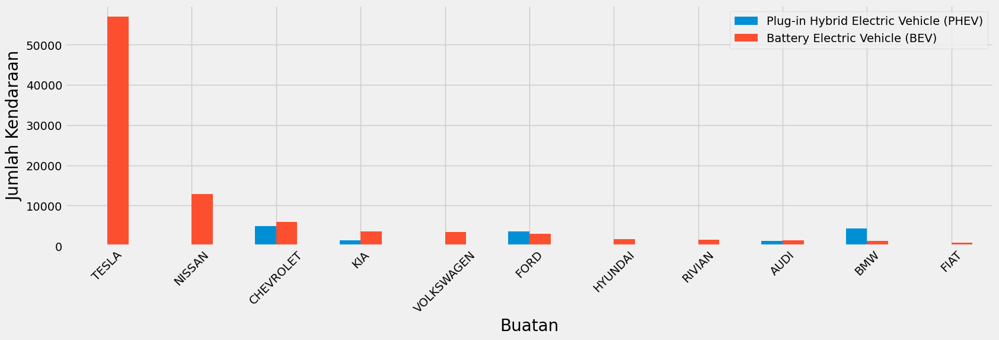

In [24]:
hev=evp_data[evp_data['Electric Vehicle Type'] == 'Plug-in Hybrid Electric Vehicle (PHEV)']['Make'].value_counts()
bev=evp_data[evp_data['Electric Vehicle Type'] == 'Battery Electric Vehicle (BEV)']['Make'].value_counts()
df = pd.DataFrame({'Plug-in Hybrid Electric Vehicle (PHEV)': hev,'Battery Electric Vehicle (BEV)': bev}, bev.index)
df=df.fillna(0)
ax = df.iloc [0:11, :].plot.bar(rot=45,figsize=(18,5))
plt.xlabel('Buatan', fontsize=20)
plt.ylabel('Jumlah Kendaraan', fontsize=20)
plt.show()

In [25]:
fig = px.bar(df.iloc[0:13, :], x=df.iloc[0:13, :].index, y=["Plug-in Hybrid Electric Vehicle (PHEV)", "Battery Electric Vehicle (BEV)"],
             labels={},  title="Tipe PHEV dan BEV per Merek",height=600,text_auto='.2s')
fig.show()

In [26]:
tahun_mobil =pd.DataFrame({'Year': evp_data[evp_data['Model Year'] <= 2022]['Model Year'].value_counts().index,'Number of Vehicule':   evp_data[evp_data['Model Year'] <= 2022]['Model Year'].value_counts()})
fig = px.line(tahun_mobil.sort_values(by='Year', ascending=False), x="Year", y="Number of Vehicule", title='Tren Jumlah Kendaraan Listrik Tahun 1997 hingga 2022')
fig.show()

In [28]:
mobil_tesla =pd.DataFrame({'Year': evp_data[evp_data['Make'] == 'TESLA']['Model Year'].value_counts().index,'Number of Vehicule':   evp_data[evp_data['Make'] == 'TESLA']['Model Year'].value_counts()})
fig = px.line(mobil_tesla.sort_values(by='Year', ascending=False), x="Year", y="Number of Vehicule", title='Tren Kendaraan TESLA dari tahun 1997 hingga kuartal pertama tahun 2023')
fig.show()

In [29]:
px.pie(evp_data,names=evp_data[evp_data['Model Year'] == 2022]['Make'].value_counts().index[:10],values=evp_data[evp_data['Model Year'] == 2022]['Make'].value_counts()[:10],height=400,title='Proporsi Jenis Kendaraan Listrik Tahun 2022 Berdasarkan Merek')


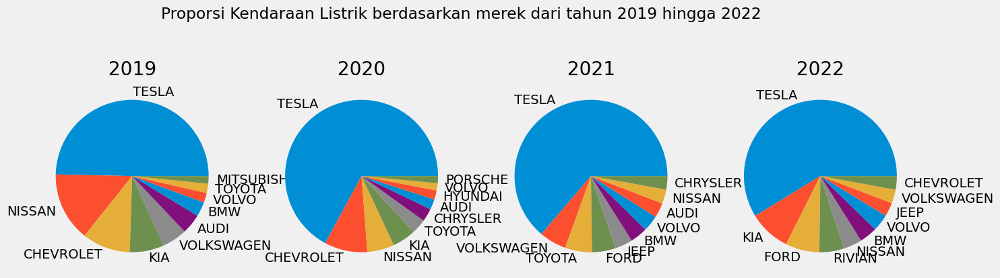

In [31]:
fig, axs = plt.subplots(1, 4, figsize=(15, 5))


for i, year in enumerate([2019, 2020, 2021, 2022]):
    make_yearly = evp_data[evp_data['Model Year'] == year]['Make'].value_counts()[:10]
    axs[i].pie(make_yearly.values, labels=make_yearly.index)
    axs[i].set_title(f" {year} ")
fig.suptitle('Proporsi Kendaraan Listrik berdasarkan merek dari tahun 2019 hingga 2022')
plt.show()

In [32]:
import plotly.graph_objects as go

fig = go.Figure()
makes = [ 'TESLA','NISSAN', 'CHEVROLET', 'KIA', 'FORD']

for make in makes:
    yearly = evp_data['Model Year'][evp_data['Make'] == make].value_counts()
    yearly = pd.DataFrame({'Year': yearly.index,'Number Of Vehicules': yearly.values}).sort_values(by=['Year'])
    fig.add_trace(go.Scatter(x=yearly[(yearly['Year']>=2010) & (yearly['Year']<=2022)]['Year'], y=yearly[(yearly['Year']>=2010) & (yearly['Year']<=2022)]['Number Of Vehicules'], mode='lines',name=make))
fig.update_layout(title='Tren jumlah kendaraan berdasarkan merek dari tahun 2010 hingga 2022 ')
fig.show()

In [37]:
bev_model_range=evp_data[evp_data['Electric Vehicle Type']=='Battery Electric Vehicle (BEV)'].sort_values(by='Electric Range',ascending=False)['Model'].unique()[:10]

print("Top 10 Models yang menggunakan Battery Electric Vehicle (BEV)")
for i in range(0, 10) :
    print(f"Number {i+1}:", bev_model_range[i])

Top 10 Models yang menggunakan Battery Electric Vehicle (BEV)
Number 1: MODEL S
Number 2: MODEL 3
Number 3: MODEL X
Number 4: MODEL Y
Number 5: BOLT EV
Number 6: KONA
Number 7: ROADSTER
Number 8: NIRO
Number 9: I-PACE
Number 10: PS2


In [38]:
phev_model_range=evp_data[evp_data['Electric Vehicle Type']=='Plug-in Hybrid Electric Vehicle (PHEV)'].sort_values(by='Electric Range',ascending=False)['Model'].unique()[:10]
print("Top 10 Models yang menggunakan Plug-in Hybrid Electric Vehicle (PHEV)")
for i in range(0, 10) :
    print(f"Number {i+1}:", phev_model_range[i])

Top 10 Models yang menggunakan Plug-in Hybrid Electric Vehicle (PHEV)
Number 1: I3
Number 2: WHEEGO
Number 3: VOLT
Number 4: CLARITY
Number 5: RAV4 PRIME
Number 6: S60
Number 7: V60
Number 8: ELR
Number 9: ESCAPE
Number 10: OUTLANDER


**Gunakan Folium untuk menemukan lokasi kendaraan ini di peta**

In [39]:
# menemukan lokasi kendaraan ini di peta
location_2022=evp_data[evp_data['Model Year']==2022]
location_2022=location_2022[['Make','Model','Vehicle Location']]
location_2022

,Make,Model,Vehicle Location
11,KIA,EV6,POINT (-122.92333 47.03779)
33,VOLVO,S60,POINT (-122.60735 46.94239)
34,TESLA,MODEL Y,POINT (-120.53113 46.65404)
78,TESLA,MODEL Y,POINT (-117.18147 46.73015)
89,RIVIAN,EDV,POINT (-122.66122 47.56573)
...,...,...,...
124700,TESLA,MODEL Y,POINT (-122.06402 48.01497)
124701,TOYOTA,RAV4 PRIME,POINT (-122.29245 47.82557)
124706,VOLVO,C40,POINT (-122.41666 47.30682)
124707,JEEP,GRAND CHEROKEE,POINT (-119.55125 47.31867)


In [40]:
#buat data baru dengan kolom nilai terpisah
new = location_2022['Vehicle Location'].str.split(" ", n = 1, expand = True)

new=new[1]
new=new.str[1:-1]
new = new.str.split(" ", n = 1, expand = True)
# membuat kolom nama depan terpisah dari data baru
new["Longitude"]= new[0]

#membuat kolom nama belakang terpisah dari data baru
new["Latitude"]= new[1]
new=new[["Longitude","Latitude"]]
new

location_2022.insert(loc=2, column='Longitude', value=new["Longitude"])
location_2022.insert(loc=3, column='Latitude', value=new["Latitude"])
location_2022

,Make,Model,Longitude,Latitude,Vehicle Location
11,KIA,EV6,-122.92333,47.03779,POINT (-122.92333 47.03779)
33,VOLVO,S60,-122.60735,46.94239,POINT (-122.60735 46.94239)
34,TESLA,MODEL Y,-120.53113,46.65404,POINT (-120.53113 46.65404)
78,TESLA,MODEL Y,-117.18147,46.73015,POINT (-117.18147 46.73015)
89,RIVIAN,EDV,-122.66122,47.56573,POINT (-122.66122 47.56573)
...,...,...,...,...,...
124700,TESLA,MODEL Y,-122.06402,48.01497,POINT (-122.06402 48.01497)
124701,TOYOTA,RAV4 PRIME,-122.29245,47.82557,POINT (-122.29245 47.82557)
124706,VOLVO,C40,-122.41666,47.30682,POINT (-122.41666 47.30682)
124707,JEEP,GRAND CHEROKEE,-119.55125,47.31867,POINT (-119.55125 47.31867)


In [41]:
location_2022=location_2022[['Make','Model','Longitude','Latitude']]
location_2022

,Make,Model,Longitude,Latitude
11,KIA,EV6,-122.92333,47.03779
33,VOLVO,S60,-122.60735,46.94239
34,TESLA,MODEL Y,-120.53113,46.65404
78,TESLA,MODEL Y,-117.18147,46.73015
89,RIVIAN,EDV,-122.66122,47.56573
...,...,...,...,...
124700,TESLA,MODEL Y,-122.06402,48.01497
124701,TOYOTA,RAV4 PRIME,-122.29245,47.82557
124706,VOLVO,C40,-122.41666,47.30682
124707,JEEP,GRAND CHEROKEE,-119.55125,47.31867


**Menampilkan lokasi semua kendaraan**

In [42]:
location_2022 = location_2022[["Latitude", "Longitude", "Make"]]
location_2022

map_location_2022 = folium.Map(location=[47.03779, -122.92333], zoom_start=6)

location_2022.apply(lambda row:folium.CircleMarker(location=[row["Latitude"],
                                                  row["Longitude"]]).add_to(map_location_2022),
     axis=1)
map_location_2022

In [43]:
#contoh lokasi merk tesla
location_2022 = location_2022[["Latitude", "Longitude", "Make"]]
location_2022_tesla=location_2022[location_2022['Make']=='TESLA']

map_location_2022_tesla = folium.Map(location=[47.03779, -122.92333], zoom_start=6)

location_2022_tesla.apply(lambda row:folium.CircleMarker(location=[row["Latitude"],
                                                  row["Longitude"]]).add_to(map_location_2022_tesla),
     axis=1)
map_location_2022_tesla